# Python Machine Learning exercise

Made by Ties van der Heijden, TU Delft

In this exercise we will forecast Day Ahead Market prices of the Dutch market. To achieve this, some feature extraction analysis will be performed. These will then be implemented in a MultiLayer Perceptron from SciKit Learn.

It is recommended to consult the documentation of the functions to find out what parameters are needed for what function.

# Package import

We will start with importing the relevant packages.
These include:
- Numpy
- Pandas
- Scipy

Besides that the following packages are always handy to have imported:
- Pathlib's Path
- Matplotlib
- Seaborn

We will import the following classes immediately, to save ourselves some unnecessary typing:
- MLPRegressor (SKLearn)
- lasso_path (SKLearn)
- plot_acf, plot_pacf (Statsmodels)
- dump (joblib)

In [1]:
import pandas as pd
import numpy as np
import scipy as sp

from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import lasso_path
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from joblib import dump

# Read the data
Panda's function read_csv can be used to load csv files in a DataFrame.<br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.read_csv.html

Path can be used robustly declare paths in the directory.<br>
https://docs.python.org/3/library/pathlib.html

In [2]:
path = Path(r'data')
dam = pd.read_csv(path / 'DAM_NL.csv', index_col = 0, parse_dates = True)
load = pd.read_csv(path / 'LOAD_NL.csv', index_col = 0, parse_dates = True)

# Plot the data
The data is imported. You can now use pandas and matplotlib to inspect the data. Pandas daterange objects are ideal for making index-cuts in the DataFrame.

Use Pandas index indicators to plot from 05-03-2018 00:00 untill 13-03-2018 00:00.

Hint: declare a DateRange using pandas Datetime objects. These can be used in combination with the index.isin() function.<br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.loc.html <br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.date_range.html <br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.isin.html

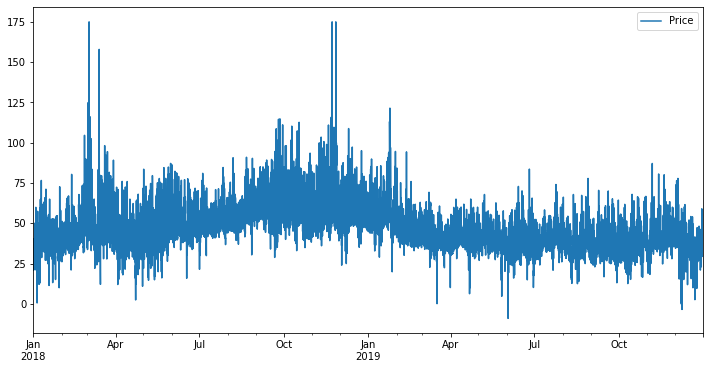

In [3]:
dam.loc[dam.index.year >= 2018].plot(figsize=(12,6))

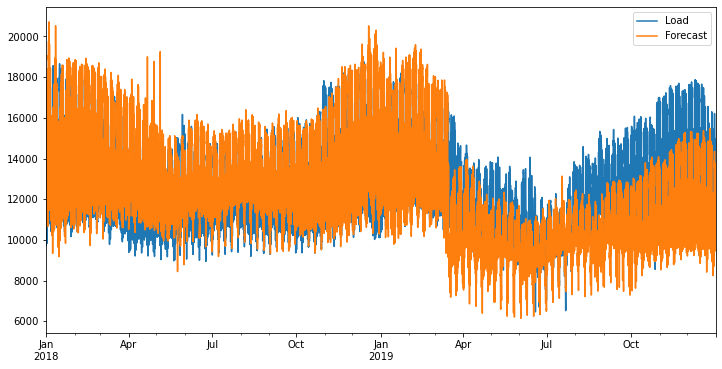

In [4]:
load.loc[load.index.year >= 2018].plot(figsize=(12,6))

# Fill data gaps
The load data also include a day-ahead forecast. Which is exactly what we want when forecasting DAM prices on a day-ahead basis. Scatter plot the Forecast and the Load against each other (Load on X-axis, Forecast on Y-axis).

The DataFrames can contain NaN values. Check for the presence of NaN values, and if present linearly interpolate between the same time of the surrounding days. Keep the datasets as long as possible. Hint: use the index.hour and index.minute functionalities to fill NaN's per time of the day. <br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.interpolate.html

The Load dataframe is in timesteps of 15 minutes, while the DAM is hourly. Resample the Load dataframe to be in hourly resolution as well, but with mean values of the quarterly values. <br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.resample.html

In [5]:
from termcolor import colored

print(), print(colored('From this point onward, the exercise was performed by Timo Vijn', 'green')), print();

print(colored('v1.0 (2021, Jan 20)', 'green')), print();


From this point onward, the exercise was performed by Timo Vijn

v1.0 (2021, Jan 20)



In [6]:
from scipy import stats
from itertools import cycle

from datetime import datetime

from sklearn.model_selection import RandomizedSearchCV

from sklearn.metrics import explained_variance_score
from sklearn.metrics import mean_squared_error as mse

import joblib

print(''), print(colored('Finished','green'));


Finished


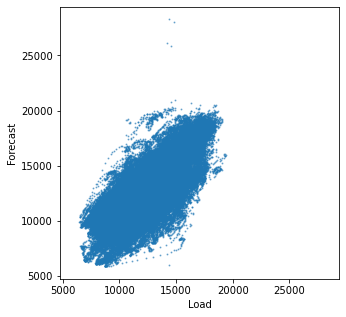


Finished


In [7]:
fig, ax = plt.subplots(figsize=(5, 5))

x = load['Load']
y = load['Forecast']
ax.scatter(x, y, s = 1, alpha = 0.5)
xymax = max(np.nanmax(x), np.nanmax(y))
xymin = max(np.nanmin(x), np.nanmin(y))
ax.set_xlim(xymin - 0.05 * (xymax - xymin), xymax + 0.05 * (xymax - xymin))
ax.set_ylim(xymin - 0.05 * (xymax - xymin), xymax + 0.05 * (xymax - xymin))
ax.set_title(f'')
ax.set_xlabel(r'Load')
ax.set_ylabel(r'Forecast');

plt.show()

print(''), print(colored('Finished','green'));

In [8]:
dam_raw = dam
load_raw = load

# Remove all rows at the start that have no full row
dam = dam_raw.loc[dam_raw.index >= dam_raw.first_valid_index()] 
load = load_raw.loc[load_raw.index >= max(load_raw['Load'].first_valid_index(), load_raw['Forecast'].first_valid_index())]

# Select rows that have NaN
dam_nan = dam.loc[dam['Price'].isnull()]
load_nan = load[ (load['Load'].isnull()) | (load['Forecast'].isnull()) ]

print(), print(colored('...')), print(), print(colored(f'Amount of rows with NaN:', 'blue')), print(), print(colored(f'Price: {len(dam_nan)}', 'blue')), print(), print(colored(f'Load: {len(load_nan)}', 'blue')), print(''), print(colored('...')), print()

# Iterate over rows that have NaN
for idx, row in dam_nan.iterrows():

    # Select rows that have same hour & minute as NaN row
    dam_intp = dam.loc[(dam.index.hour == idx.hour) & (dam.index.minute == idx.minute)]

    # Linear interpolation
    dam_intp = dam_intp.interpolate()

# Iterate over rows that have NaN
for idx, row in load_nan.iterrows():

    # Select rows that have same hour & minute as NaN row
    load_intp = load.loc[(load.index.hour == idx.hour) & (load.index.minute == idx.minute)]

    # Linear interpolation
    load_intp = load_intp.interpolate()

    load[load.index == idx] = load_intp[load_intp.index == idx]

print(''), print(colored('Finished','green'));


...

Amount of rows with NaN:

Price: 0

Load: 1

...


Finished


In [9]:
# Resample quarter hour to hour
load = load.resample('1H').mean()

print(''), print(colored('Finished','green'));


Finished


# Autocorrelation

Let's first look how far we need to look back in the timeseries to make a prediction about the future. This can be done with Autocorrelation and Partial Autocorrelation. Statsmodels has nice functions for that: plot_acf and plot_pacf.

Plot the ACF and PACF of the DAM timeseries with lags up to 14 days.<br>
https://www.statsmodels.org/dev/generated/statsmodels.tsa.stattools.acf.html <br>
https://www.statsmodels.org/stable/generated/statsmodels.tsa.stattools.pacf.html

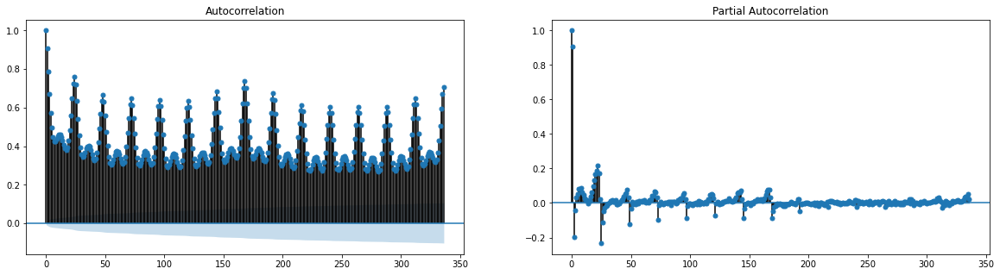


Finished


In [10]:
# Plot ACF and PACF

fig, ax = plt.subplots(1, 2, figsize = (20,5))
plot_acf(dam['Price'], lags = 14*24, ax = ax[0])
plot_pacf(dam['Price'], lags = 14*24, ax = ax[1])
plt.show()

print(''), print(colored('Finished','green'));

# LASSO analysis
We observe that autocorrelation can be relevant up to about a week lag. We can use this to limit our data analysis.
Now we find relevant hours using LASSO. LASSO stands for Least Absolute Shrinkage and Selection Operator, which is a regluarization technique we will use to filter out irrelevant lags.

Generally in timeseries regression, historic values are given as seperate features.
These can be passed on in a Numpy Array. Where the rows are the samples and the columns are the features.
In our training-set we don't want to include the target variable (actual price).

Most ML algorithms perform better when the data is standardized. We will apply a Z-score standardization:
Y = (X - mean)/std

1. Scale the DAM and Load forecast data using Z-score standardization.


2. Construct a dataframe where the columns represent lagged (standardized) values of the timeseries.

Column 0 is the actual price, column 1 is one hour shifted in time. And so on, untill t = 168. Hint: use DataFrame.shift(). Make sure you get rid of the resulting NaN values.


3. Create a numpy array with the target variables (Y).


4. Create a numpy array with the lagged prices from 24 - 168 hours for all samples.


5. Use lasso_path to compute the LASSO-coefficients


6. Plot the LASSO-coefficients over the -log of the LASSO-alphas.

Useful links:<br>
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.shift.html <br>
https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html#sklearn.linear_model.Lasso <br>
https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.lasso_path.html

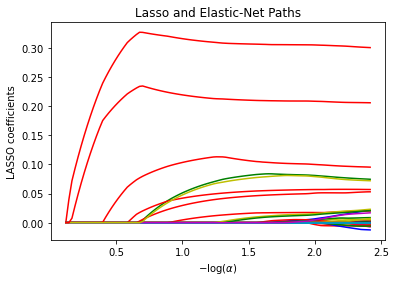


Finished


In [11]:
# Scaling of data using Z-score standardization
dam_z = dam.apply(stats.zscore)
load_z = load.apply(stats.zscore)

# # Use below to export non-scaled X and y

# dam_z = dam
# load_z = load

dam_lag = dam_z
dam_lag_price = dam

# Iterate for 168 lagged prices
for i in range(0, 168):

    if i == 0:
        dam_lag[f'Lag {i+1}'] = dam_lag[f'Price'].shift(periods = 1)
        dam_lag_price[f'Lag {i+1}'] = dam[f'Price'].shift(periods = 1)
        continue

    dam_lag[f'Lag {i+1}'] = dam_lag[f'Lag {i}'].shift(periods = 1)
    dam_lag_price[f'Lag {i+1}'] = dam[f'Lag {i}'].shift(periods = 1)

# Drop rows containing NaN
dam_lag = dam_lag.dropna()
dam_lag_price = dam_lag_price.dropna()

# Target variables
y = np.array(dam_lag['Price'])
X = dam_lag.loc[: , 'Lag 24':]
X = X.to_numpy()

eps = 5e-3

alphas_lasso, coefs_lasso, _ = lasso_path(X, y, eps)

plt.figure(1)
ax = plt.gca()

colors = cycle(['r', 'g', 'b', 'c', 'm', 'y'])
neg_log_alphas_lasso = -np.log10(alphas_lasso)

for coef_l, c in zip(coefs_lasso, colors):
    l1 = plt.plot(neg_log_alphas_lasso, coef_l, c=c)

plt.xlabel(r'$-\log(\alpha)$')
plt.ylabel('LASSO coefficients')
plt.title('Lasso and Elastic-Net Paths')
plt.axis('tight')
plt.show()

print(''), print(colored('Finished','green'));

# Heatmap
Since these plots dont show much overview, let's try a heatmap. Plot a seaborn heatmap with on the x-axis the delayed timesteps, on the y-axis the -log alphas and the color the Lasso coefficients. <br>
https://seaborn.pydata.org/generated/seaborn.heatmap.html

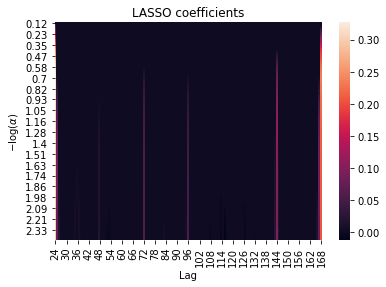


Finished


In [12]:
# Calculate LASSO coefficiencts
coefs_lasso_transpose = np.transpose(coefs_lasso)
coefs_lasso_transpose = pd.DataFrame(data=coefs_lasso_transpose)
coefs_lasso_transpose = coefs_lasso_transpose.set_index(neg_log_alphas_lasso.round(2))
coefs_lasso_transpose = coefs_lasso_transpose.rename(columns={x:y for x,y in zip(coefs_lasso_transpose.columns,range(24,len(coefs_lasso_transpose.columns)+24))})

# Plot heatmap
ax = sns.heatmap(coefs_lasso_transpose)
ax.set_title(f'LASSO coefficients')
ax.set_xlabel(r'Lag')
ax.set_ylabel(r'$-\log(\alpha)$')
plt.show()

print(''), print(colored('Finished','green'));

# Feature creation
Some hours seem to stick out in importance. Which ones?
Select the 4 most important lags.

For DAM forecasting we would like to take daily patters into account.
We can do this through Multivariate regression: we forecast all 24 prices at the same time.

Our target matrix, Y, will have a row for every day. And a column for every hour of the day.
Our training matrix, X, will have a row for every day, and a column for all the relevant delayed hours, for all hours of the day. Besides that, the training matrix will include 24 Load forecasts - one for each hour of the day.

Shape target: (N_days, 24)

Shape training: (N_days, 24*n_lags + 24)

- Make the X and Y matrices.

The order of the columns is irrelevant in X, since the algorithm will find relevant relationships.
You can use np.unique() to filter out duplicate columns. <br>
https://docs.scipy.org/doc/numpy/reference/generated/numpy.array.html <br>
https://docs.scipy.org/doc/numpy/reference/generated/numpy.unique.html

In [13]:
# Create features

coefs_lasso = coefs_lasso_transpose.transpose()
coefs_lasso['Mean'] = coefs_lasso.mean(axis=1)

coefs_lasso_important = coefs_lasso.sort_values('Mean', ascending = False).head(4)

print(), print(colored('...')), print(), print(colored(f'Most important lags:', 'blue')), print(), print(coefs_lasso_important['Mean']), print(), print(colored('...')), print();

print(''), print(colored('Finished','green'));


...

Most important lags:

24     0.285445
168    0.195988
144    0.081929
25     0.051090
Name: Mean, dtype: float64

...


Finished


In [14]:
# dates = dam_lag.index.map(pd.Timestamp.date).unique().values

# feat_y = pd.DataFrame()
# feat_X = pd.DataFrame()

# # Iterate over unique days
# for i in dates:
#     print(i, end='\r')
#     print()

#     # Construct y
#     ii = dam.iloc[dam.index.date == i]['Price']
#     ii.index = ii.index.strftime('%-H')
#     ii = ii.to_frame().transpose()
#     ii.index = [i]
#     feat_y = feat_y.append(ii)

#     # Construct X
#     for c in coefs_lasso_important.index:
#         ii = dam_lag.iloc[dam_lag.index.date == i][f'Lag {c}']
#         ii.index = ii.index.strftime(f'Lag {c} (%-H)')
#         ii = ii.to_frame().transpose()
#         ii.index = [i]
#         feat_X = feat_X.append(ii)
    
#     ii = load_z.iloc[load_z.index.date == i]['Forecast']
#     ii.index = ii.index.strftime(f'Load forecast (%-H)')
#     ii = ii.to_frame().transpose()
#     ii.index = [i]
#     feat_X = feat_X.append(ii)

# feat_X = feat_X.groupby(feat_X.index).sum()

# feat_X.to_pickle('./features/feat_X.pkl')
# feat_y.to_pickle('./features/feat_y.pkl')

# Split the samples
Allmost there. 

In order to evaluate our model we should keep a bit of the data for ourselves, so we can test it on data it hasn't seen before. A rule of thumb is to used 1/3 as test set, and 2/3rds as training set. However, we are going to use a 5-fold cross validation. Where the whole dataset is split into 5 batches, and we train the model 5 times using 1 of the 5 batches to score and the other 4 for training. So we just keep 10% of our data samples out of training.

- Split the X and Y matrices into 1/10th and 9/10th of the samples.

In [15]:
# Split train/test

feat_X = pd.read_pickle(f"./features/feat_X.pkl")
feat_y = pd.read_pickle(f"./features/feat_y.pkl")

from sklearn.model_selection import train_test_split

perc_test = 0.1

X_train, X_test, y_train, y_test = train_test_split(feat_X, feat_y, test_size = perc_test, shuffle = False, random_state = 1236548)
print('Number of samples in the training set:', X_train.shape[0])
print('Number of samples in the test set:', X_test.shape[0])

print(''), print(colored('Finished','green'));

Number of samples in the training set: 1632
Number of samples in the test set: 182

Finished


# Hyperparameter search
Now train an MLPRegressor with two hidden layers.

Use GridSearchCV with the following ranges for the nodes/layer:
- nodes in layer 1: range(100, 250, 50)
- nodes in layer 2: range(40, 70, 10)

Use 5-fold cross validation, and set early_stopping to True.

Note: this might take a while to finish. Feel free to play around with extra hyperparameter tuning or feature analysis.<br>
https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html <br>
https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html

In [16]:
# Define base regressor
base_reg = MLPRegressor     (   learning_rate = 'adaptive',
                                max_iter = 5000,
                                random_state = 42,
                                early_stopping = True,
                                activation = 'relu'
                            )

hl = [ (x, y) for x in [*range(100, 250, 50)] for y in [*range(40, 70, 10)] ]

# Define search space
params =                    {   'hidden_layer_sizes': hl
                            }

# Find best hyper params and then refit on all training data
reg = GridSearchCV          (   estimator = base_reg,
                                param_grid = params,
                                n_jobs = 4,
                                cv = 5,
                                refit = True,
                                verbose = 5
                            )

reg.fit(X_train, y_train)

print(''), print(colored('Finished','green'));

Fitting 5 folds for each of 9 candidates, totalling 45 fits
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:   17.1s
[Parallel(n_jobs=4)]: Done  45 out of  45 | elapsed:  1.0min finished

Finished


# Extract, retrain, forecast and save.
- Extract the best model with the best_estimator_ class.
- Re-train this model with the whole 9/10th of the dataset.
- Forecast the prices on the 1/10th of data you kept from the model.
- Rearrange the daily predictions into an hourly timeserie.
- Plot the forecasted values and the actual values.
- Compute the Mean Absolute Error and the Root Mean Squared Error.
- Save your trained model using joblib's dump.

In [17]:
print(reg.best_estimator_)

print(reg.best_params_)

print(''), print(colored('Finished','green'));

MLPRegressor(early_stopping=True, hidden_layer_sizes=(150, 40),
             learning_rate='adaptive', max_iter=5000, random_state=42)
{'hidden_layer_sizes': (150, 40)}

Finished


In [18]:
MLP = reg.best_estimator_
MLP.fit(X_train,y_train)

# Evaluate train/test score
predictions_train_MLP = MLP.predict(X_train)
train_error_MLP= mse(y_train, predictions_train_MLP)
print('Training Error:',train_error_MLP)
predictions_test_MLP = MLP.predict(X_test)
test_error_MLP= mse(y_test, predictions_test_MLP)
print('Test Error:', test_error_MLP)
score_MLP=MLP.score(X_train, y_train)
print('R^2 returned by the MLP:', score_MLP)

print(''), print(colored('Finished','green'));

Training Error: 43.80126673341476
Test Error: 42.44102042391544
R^2 returned by the MLP: 0.7418584612134241

Finished


In [19]:
# Make forecast

prd = MLP.predict(X_test)
prd = pd.DataFrame(prd)

prd.index = X_test.index

PRD = pd.DataFrame()

for index, row in prd.iterrows():
    index = datetime.combine(index, datetime.min.time())
    row = pd.DataFrame(row)
    row = row.rename(columns={row.columns[0]: "Price" })
    for index2, row2 in row.iterrows():
        s = row2
        s.name = index.replace(hour=index2)
        PRD = PRD.append(s)
PRD = PRD.sort_index()
dam2 = dam.loc[PRD.index]

print(''), print(colored('Finished','green'));


Finished


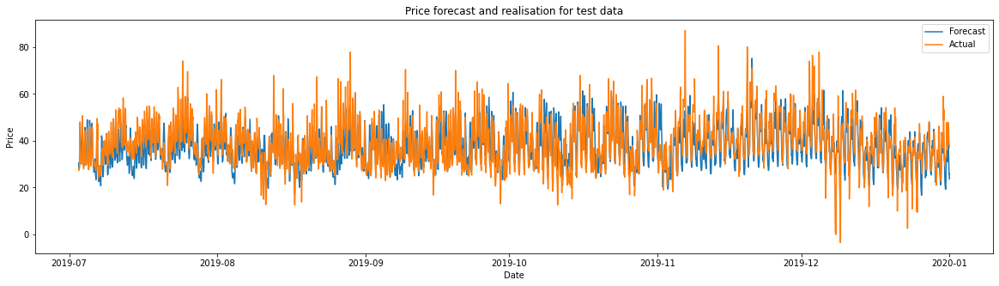


Finished


In [20]:
# Plot actual and forecast

fig, ax = plt.subplots(figsize = (20, 5))

x = PRD.index
y = PRD
ax.plot(x, y, label = 'Forecast')

x = dam2.index
y = dam2['Price']
ax.plot(x, y, label = 'Actual')

ax.set_title(f'Price forecast and realisation for test data');
ax.set_xlabel(r'Date');
ax.set_ylabel(r'Price');
ax.legend();
plt.show()

print(''), print(colored('Finished','green'));

In [21]:
# Evaluate forecast with MAE and RMSE

from sklearn.metrics import mean_absolute_error as MAE
from sklearn.metrics import mean_squared_error as MSE

print(f'MAE: {MAE(y_test, predictions_test_MLP)}')
print(f'RMSE: {MSE(y_test, predictions_test_MLP, squared = False)}')

print(''), print(colored('Finished','green'));

MAE: 5.019539752354714
RMSE: 6.4066612426020875

Finished


In [22]:
# Save model to disk

joblib.dump(MLP, './finalized_model.sav')

print(''), print(colored('Finished','green'));


Finished


In [23]:
# Load model from disk
loaded_model = joblib.load('./finalized_model.sav')
result = loaded_model.score(X_test, y_test)
print(result)

print(''), print(colored('Finished','green'));

0.24770496260224908

Finished
